Experiment 1

VGG16 OpenCV data augmentation

In [2]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping

import scipy.io
import numpy as np
import os
from PIL import Image
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [3]:
# Do we have access to a GPU? Sanity Check
device_list = tf.config.list_physical_devices()
if "GPU" in [device.device_type for device in device_list]:
  print(f"[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!")
  print(f"[INFO] Accessible devices:\n{device_list}")
else:
  print(f"[INFO] TensorFlow does not have GPU available to use. Models may take a while to train.")
  print(f"[INFO] Accessible devices:\n{device_list}")

[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!
[INFO] Accessible devices:
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
import os
path = '/kaggle/input/cats-in-the-wild-image-classification/train/'
len(os.listdir(path))

10

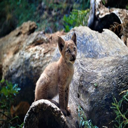

In [5]:
from PIL import Image

im =Image.open('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image100.jpg').resize((128,128))
im

In [6]:
cat_labels = set()

    
for d in os.listdir(path):
    cat_labels.add(d)

In [7]:
len(cat_labels)
num_classes = len(cat_labels)
batch_size = 32

In [8]:
cats_labels = list(cat_labels)
cats_labels_path = [path + s for s in cats_labels]

In [9]:
import cv2
def load_and_preprocess_image(path):
    image = cv2.imread(path)
    image = cv2.resize(image, (224,224))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [10]:
X = []
y = []

for type_path, label in zip(cats_labels_path,cats_labels) :
    for image_path in os.listdir(type_path):
        image = load_and_preprocess_image(type_path+"/"+image_path)
        
        X.append(image)
        y.append(label)

2339


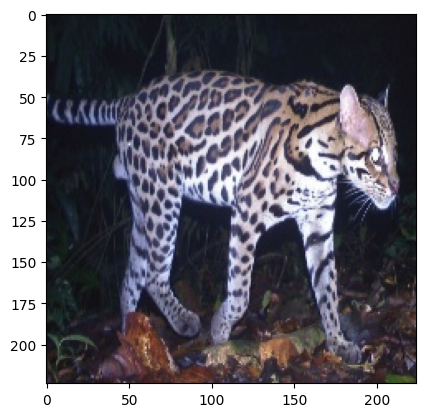

In [11]:
import matplotlib.pyplot as plt
print(len(X))
plt.imshow(X[100])

In [12]:
from sklearn.preprocessing import LabelBinarizer
import numpy as np
encoder = LabelBinarizer()

X = np.array(X)
y = encoder.fit_transform(np.array(y))

In [13]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42, shuffle=True)

In [14]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False)

x=base_model.output
x=GlobalAveragePooling2D()(x)
x=Dense(1024,activation='relu')(x)
x=Dropout(0.5)(x)
x=Dense(512,activation='relu')(x)
x=Dropout(0.2)(x)
x=Dense(256,activation='relu')(x)
preds=Dense(num_classes,activation='softmax')(x)

model=Model(inputs=base_model.input,outputs=preds)

for layer in model.layers[:-5]:
    layer.trainable=False
for layer in model.layers[-5:]:
    layer.trainable=True
    
model.compile("adam",loss="categorical_crossentropy",metrics=["accuracy"])

print(model.summary())

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, None, None, 64)      │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, None, None, 64)      │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, None, None, 64)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, None, None, 128)     │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, None, None, 128)     │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, None, None, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, None, None, 256)     │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, None, None, 256)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, None, None, 512)     │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │         525,3

 Total params: 15,898,698 (60.65 MB)

 Trainable params: 658,698 (2.51 MB)

 Non-trainable params: 15,240,000 (58.14 MB)

None


In [15]:
from tensorflow.keras.callbacks import ReduceLROnPlateau
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(patience=10, verbose=1,restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(factor=0.1, patience=10,verbose=1)

In [16]:
history = model.fit(X_train,y_train,batch_size=batch_size,epochs=50,validation_data=(X_test,y_test), callbacks=[checkpoint,earlystop, reduce_lr])

Epoch 1/50
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.3368 - loss: 3.9821
Epoch 1: val_loss improved from inf to 0.81454, saving model to ./base.model.keras
59/59 ━━━━━━━━━━━━━━━━━━━━ 27s 271ms/step - accuracy: 0.3390 - loss: 3.9568 - val_accuracy: 0.7201 - val_loss: 0.8145 - learning_rate: 0.0010
Epoch 2/50
58/59 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.6483 - loss: 1.1282
Epoch 2: val_loss improved from 0.81454 to 0.54242, saving model to ./base.model.keras
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 82ms/step - accuracy: 0.6487 - loss: 1.1260 - val_accuracy: 0.8077 - val_loss: 0.5424 - learning_rate: 0.0010
Epoch 3/50
58/59 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.7345 - loss: 0.8350
Epoch 3: val_loss did not improve from 0.54242
59/59 ━━━━━━━━━━━━━━━━━━━━ 4s 76ms/step - accuracy: 0.7338 - loss: 0.8374 - val_accuracy: 0.7927 - val_loss: 0.5735 - learning_rate: 0.0010
Epoch 4/50
58/59 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.7370 - loss: 0.7461
Epoch 4: val_loss im

In [17]:
loss, acc = model.evaluate(X_test,y_test,verbose=0)
print(f"loss on the test set is {loss:.2f}")
print(f"accuracy on the test set is {acc:.3f}")

loss on the test set is 0.37
accuracy on the test set is 0.882


In [18]:
predictions = model.predict(X_test)

15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step


In [19]:
label_predictions = encoder.inverse_transform(predictions)

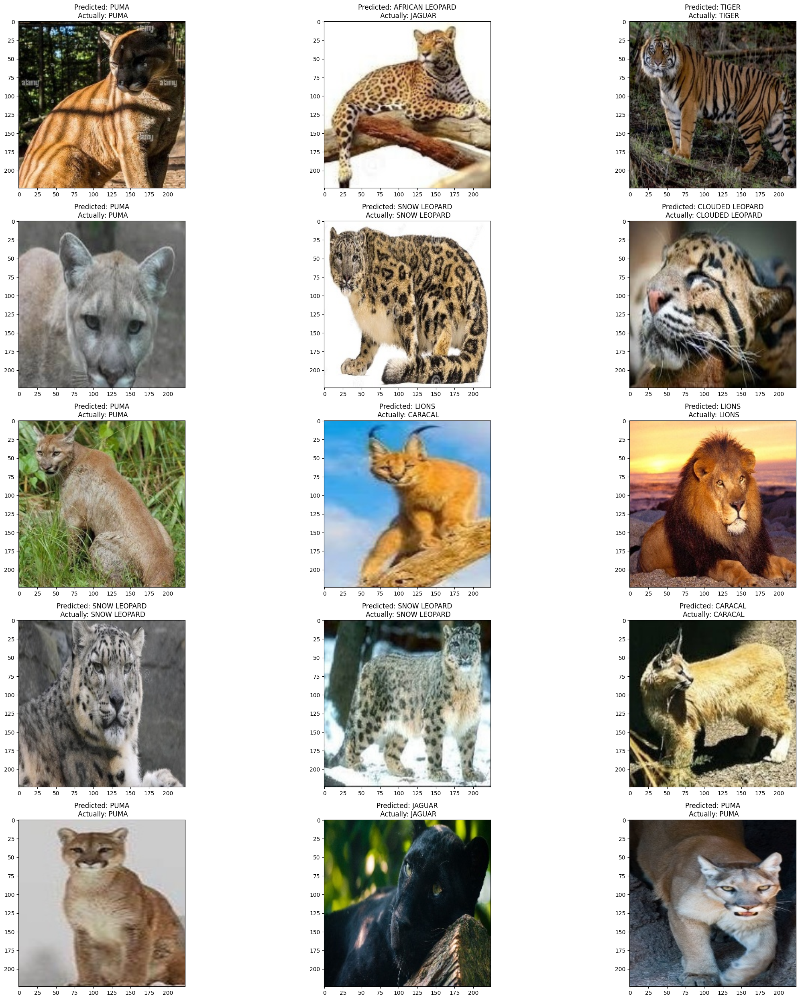

In [20]:
rows, cols = 5, 3
size = 25

fig,ax=plt.subplots(rows,cols)
fig.set_size_inches(size,size)
for i in range(rows):
    for j in range (cols):
        index = np.random.randint(0,len(X_test))
        ax[i,j].imshow(X_test[index])
        ax[i,j].set_title(f'Predicted: {label_predictions[index]}\n Actually: {encoder.inverse_transform(y_test)[index]}')
        
plt.tight_layout()

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step - accuracy: 0.8856 - loss: 0.3617


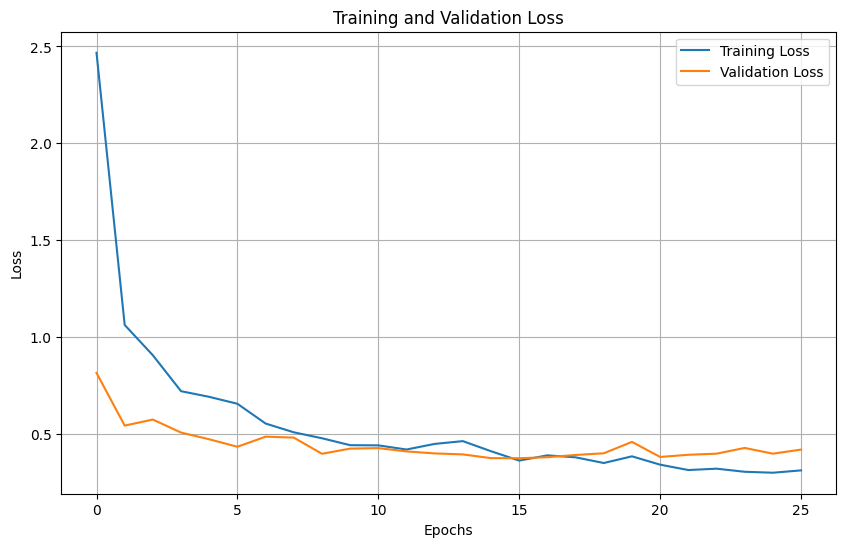

In [21]:
import matplotlib.pyplot as plt
model.evaluate(X_test, y_test)
# Extract loss values from the history object
history_dict = history.history
loss = history_dict['loss']
val_loss = history_dict['val_loss']

# Plot the loss curves
plt.figure(figsize=(10, 6))
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step


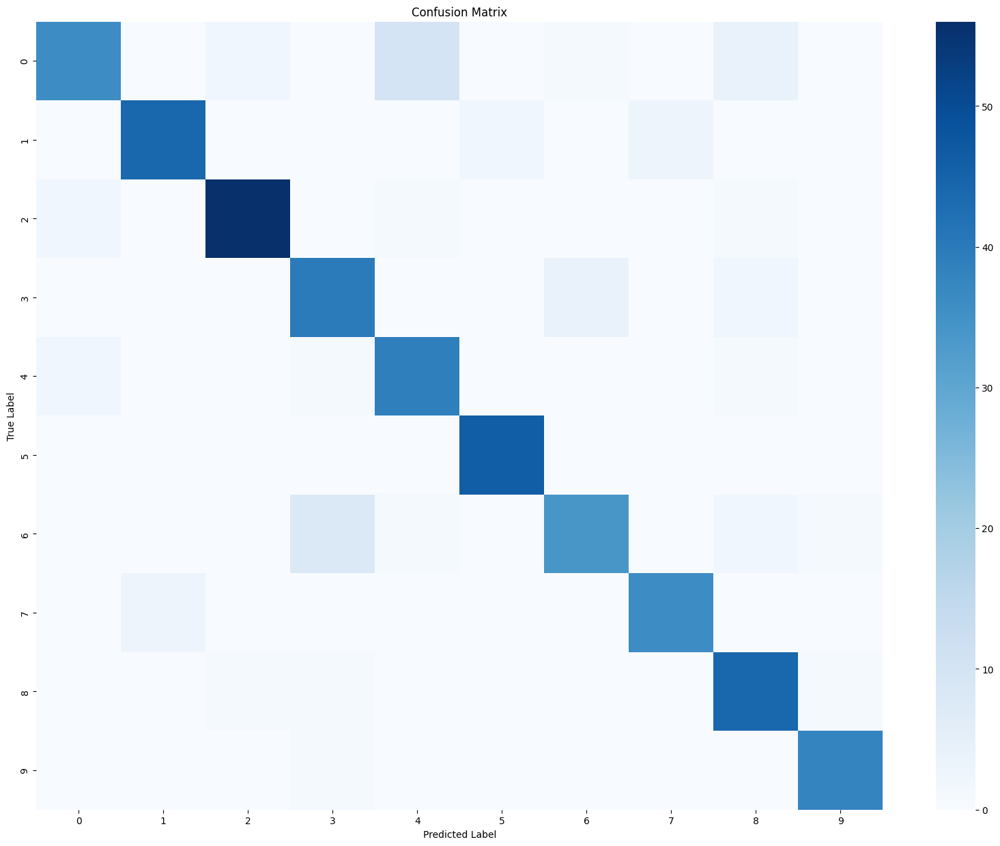

In [22]:
# Create a confusion matrix
# Assuming model predictions and true labels are available
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert predictions to class labels
y_true = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

conf_matrix = confusion_matrix(y_true, y_pred_classes)
fig, ax = plt.subplots(figsize=(20, 15))  # Adjust figsize for better visibility with 120 classes
sns.heatmap(conf_matrix, annot=False, cmap='Blues', ax=ax)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [23]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, roc_curve, auc
from sklearn.preprocessing import label_binarize
# Print classification report for precision, recall, and F1-score
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.68      0.77        53
           1       0.94      0.90      0.92        49
           2       0.95      0.93      0.94        60
           3       0.78      0.87      0.82        46
           4       0.76      0.91      0.83        43
           5       0.96      1.00      0.98        46
           6       0.87      0.74      0.80        46
           7       0.92      0.92      0.92        39
           8       0.81      0.94      0.87        47
           9       0.95      0.97      0.96        39

    accuracy                           0.88       468
   macro avg       0.89      0.89      0.88       468
weighted avg       0.89      0.88      0.88       468



In [24]:
# Plot ROC AUC curve
n_classes = y_test.shape[1]  # Number of classes
y_test_binarized = label_binarize(y_true, classes=np.arange(n_classes))

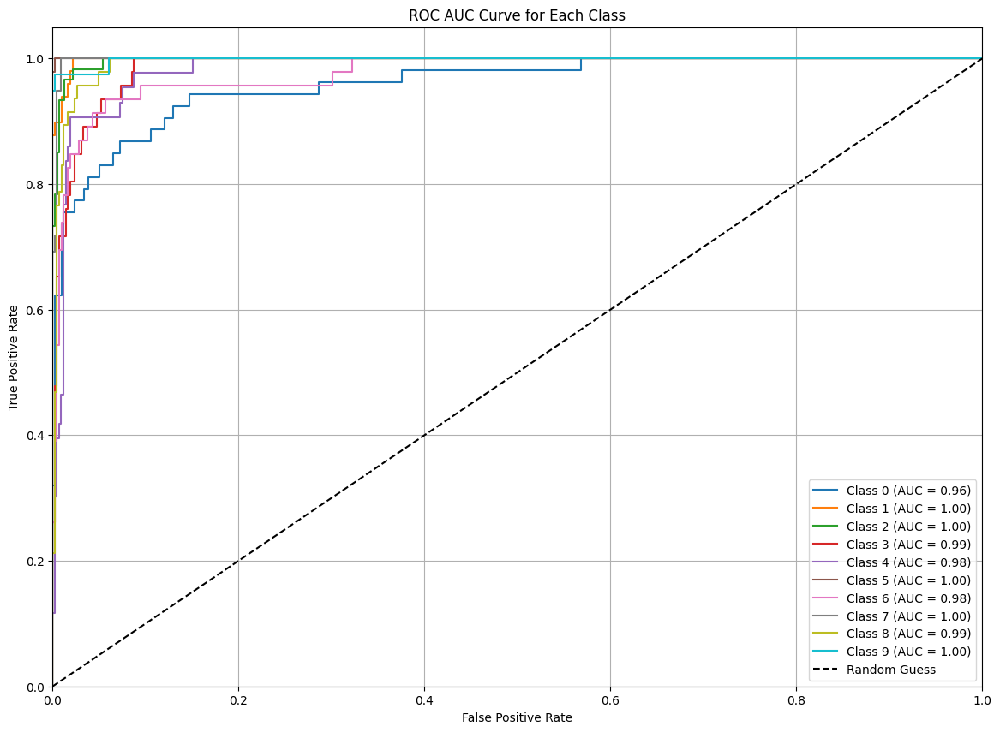

In [25]:
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC AUC curve for each class
plt.figure(figsize=(14, 10))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.title('ROC AUC Curve for Each Class')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

**Experiment 2**

***VGG16 - Image Data Augmentator*** 

In [26]:
#batch_size=32##This parameter should Be set according to your GPU/CPU capacity . Else Be Ready FOr Exhaust Error!
#num_classes = 120
image_size = 224
num_channels = 3

In [27]:
!pip install split-folders

In [28]:
import splitfolders
splitfolders.ratio(path, output="output",seed=1337, ratio=(.7, .2,.1), group_prefix=None, move=False) # default values

Copying files: 2339 files [00:02, 825.32 files/s] 


In [29]:
#VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 1633 images belonging to 10 classes.
Found 464 images belonging to 10 classes.
Found 242 images belonging to 10 classes.


In [30]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,330,186 (268.29 MB)

 Trainable params: 55,607,306 (212.13 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [31]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [32]:
history = model.fit(
        train_generator,
        epochs=25,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/25


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.3915 - loss: 1.9623
Epoch 1: val_loss improved from inf to 0.56609, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 37s 578ms/step - accuracy: 0.3943 - loss: 1.9521 - val_accuracy: 0.8168 - val_loss: 0.5661
Epoch 2/25
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step - accuracy: 0.8024 - loss: 0.6130
Epoch 2: val_loss improved from 0.56609 to 0.41067, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 25s 446ms/step - accuracy: 0.8022 - loss: 0.6134 - val_accuracy: 0.8836 - val_loss: 0.4107
Epoch 3/25
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step - accuracy: 0.8281 - loss: 0.5180
Epoch 3: val_loss improved from 0.41067 to 0.40938, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 25s 441ms/step - accuracy: 0.8281 - loss: 0.5177 - val_accuracy: 0.8858 - val_loss: 0.4094
Epoch 4/25
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step - accuracy: 0.8426 - loss: 0.4359
Epoch 4: val_loss improved from 0.40938 to 0.37180, savi

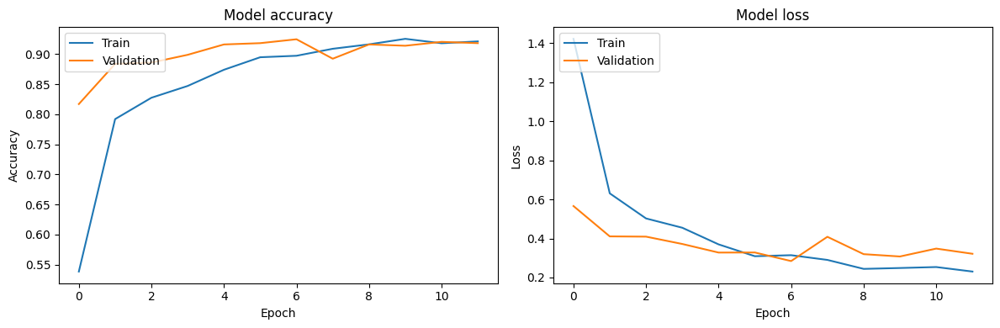

In [33]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

8/8 ━━━━━━━━━━━━━━━━━━━━ 5s 694ms/step - accuracy: 0.9214 - loss: 0.3405
Test Accuracy: 93.80%
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 121ms/step


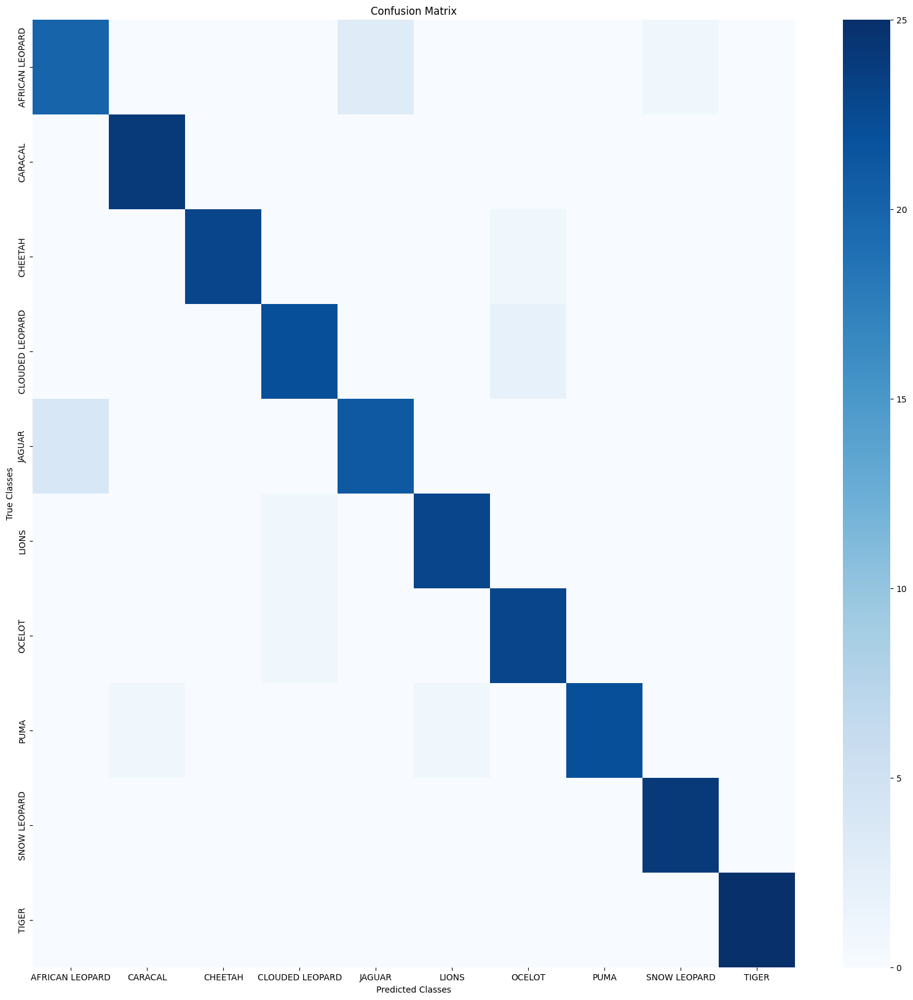

                 precision    recall  f1-score   support

AFRICAN LEOPARD       0.83      0.83      0.83        24
        CARACAL       0.96      1.00      0.98        24
        CHEETAH       1.00      0.96      0.98        24
CLOUDED LEOPARD       0.92      0.92      0.92        24
         JAGUAR       0.88      0.84      0.86        25
          LIONS       0.96      0.96      0.96        24
         OCELOT       0.88      0.96      0.92        24
           PUMA       1.00      0.92      0.96        24
   SNOW LEOPARD       0.96      1.00      0.98        24
          TIGER       1.00      1.00      1.00        25

       accuracy                           0.94       242
      macro avg       0.94      0.94      0.94       242
   weighted avg       0.94      0.94      0.94       242



In [34]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


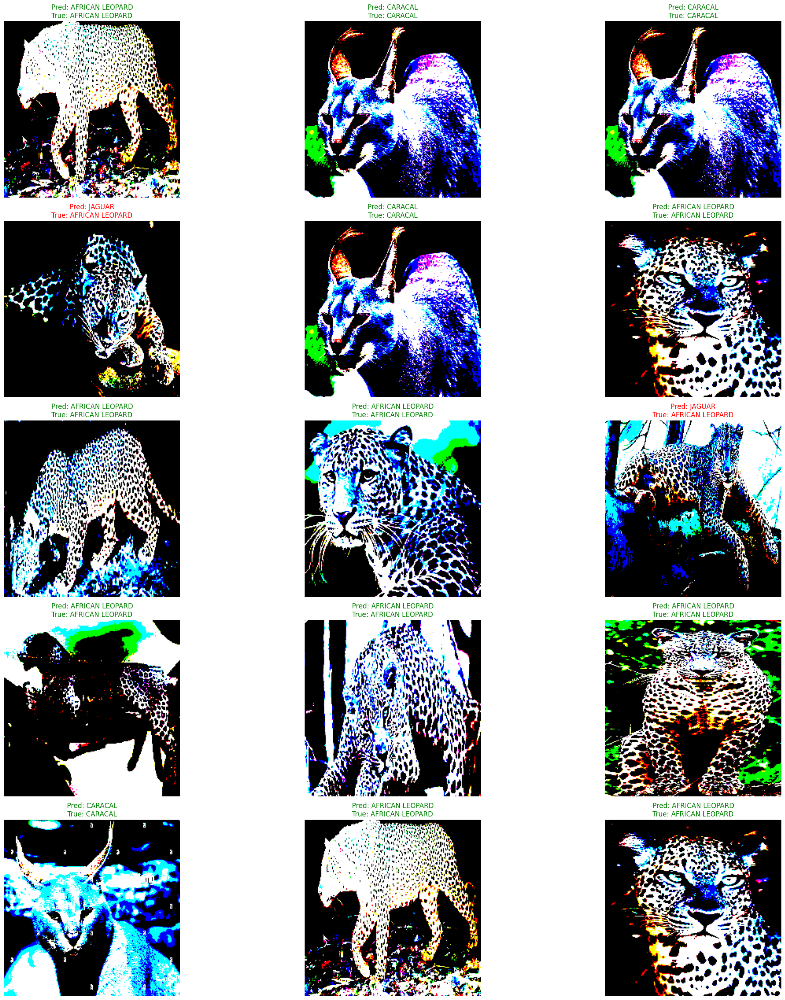

In [35]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


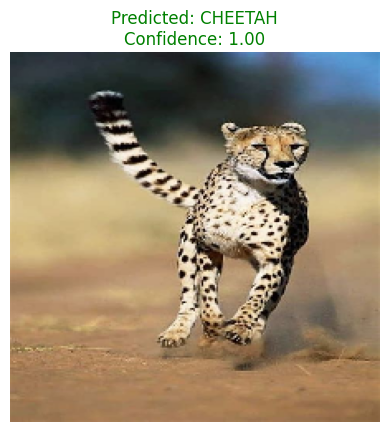

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


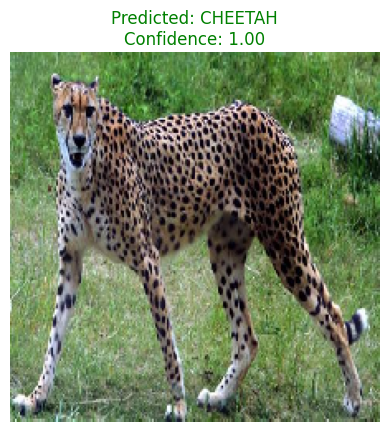

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


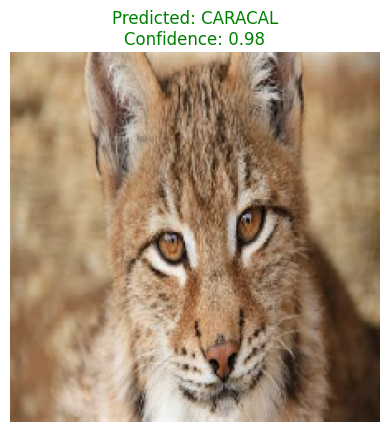

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


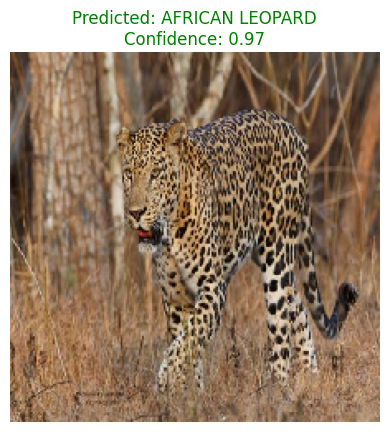

In [36]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Resnet50***

In [37]:
#ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 1633 images belonging to 10 classes.
Found 464 images belonging to 10 classes.
Found 242 images belonging to 10 classes.


In [38]:
from tensorflow.keras.applications import ResNet50
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [39]:
model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,641,930 (94.00 MB)

 Trainable params: 15,504,394 (59.14 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [40]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [41]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step - accuracy: 0.5417 - loss: 1.6713
Epoch 1: val_loss improved from inf to 58.67276, saving model to best_model.h5.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 52s 658ms/step - accuracy: 0.5448 - loss: 1.6586 - val_accuracy: 0.4310 - val_loss: 58.6728 - learning_rate: 0.0010
Epoch 2/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.8673 - loss: 0.4032
Epoch 2: val_loss improved from 58.67276 to 3.48863, saving model to best_model.h5.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 23s 395ms/step - accuracy: 0.8676 - loss: 0.4025 - val_accuracy: 0.7349 - val_loss: 3.4886 - learning_rate: 0.0010
Epoch 3/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step - accuracy: 0.8814 - loss: 0.3606
Epoch 3: val_loss did not improve from 3.48863
52/52 ━━━━━━━━━━━━━━━━━━━━ 21s 373ms/step - accuracy: 0.8815 - loss: 0.3613 - val_accuracy: 0.6250 - val_loss: 9.4868 - learning_rate: 0.0010
Epoch 4/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.9082 - loss: 0.3263
Epoch 4: val_loss i

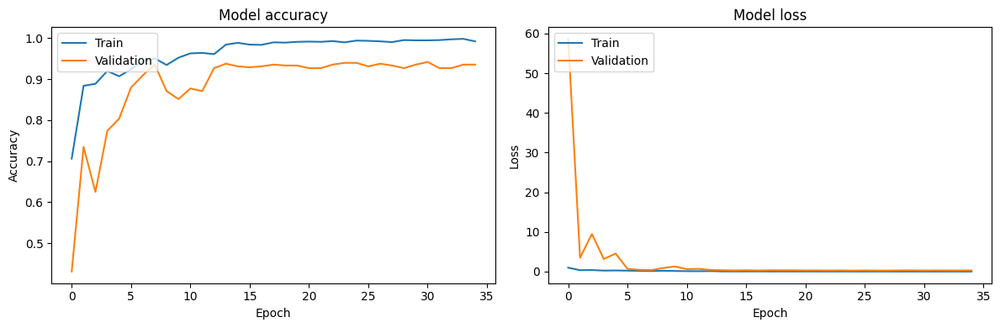

In [42]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 373ms/step - accuracy: 0.9373 - loss: 0.2476
Test Accuracy: 93.80%
8/8 ━━━━━━━━━━━━━━━━━━━━ 6s 450ms/step


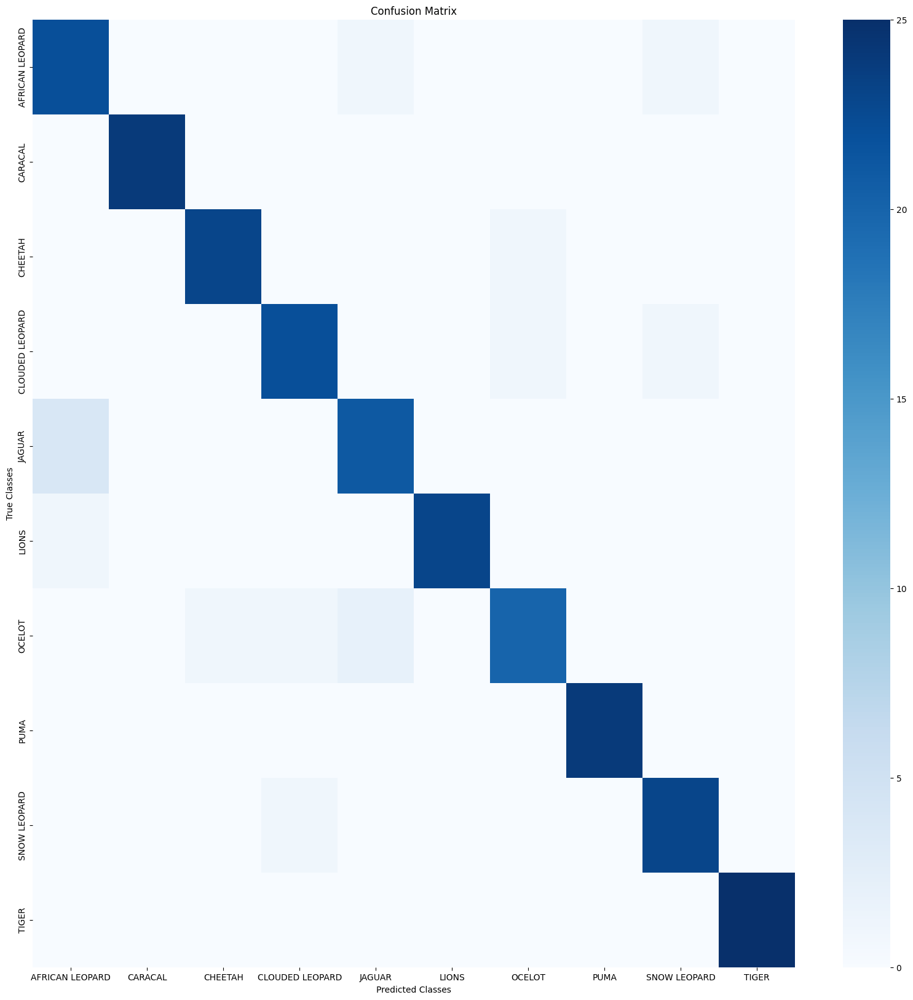

                 precision    recall  f1-score   support

AFRICAN LEOPARD       0.81      0.92      0.86        24
        CARACAL       1.00      1.00      1.00        24
        CHEETAH       0.96      0.96      0.96        24
CLOUDED LEOPARD       0.92      0.92      0.92        24
         JAGUAR       0.88      0.84      0.86        25
          LIONS       1.00      0.96      0.98        24
         OCELOT       0.91      0.83      0.87        24
           PUMA       1.00      1.00      1.00        24
   SNOW LEOPARD       0.92      0.96      0.94        24
          TIGER       1.00      1.00      1.00        25

       accuracy                           0.94       242
      macro avg       0.94      0.94      0.94       242
   weighted avg       0.94      0.94      0.94       242



In [43]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


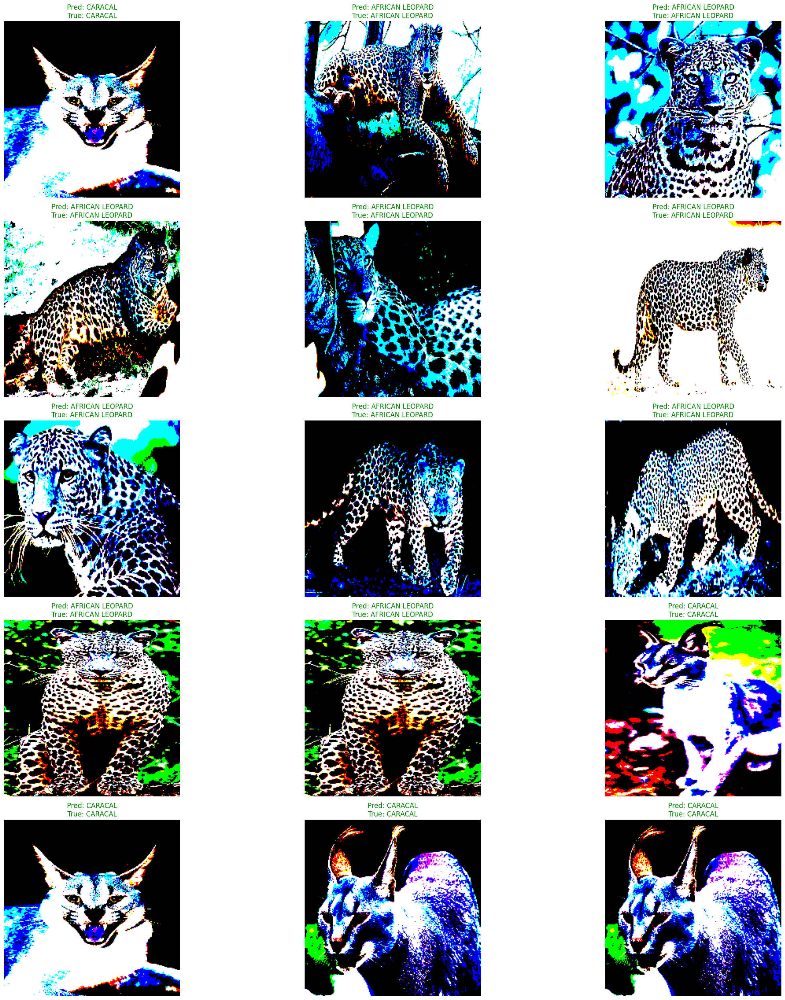

In [44]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


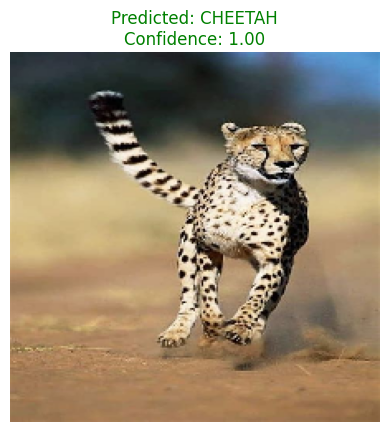

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


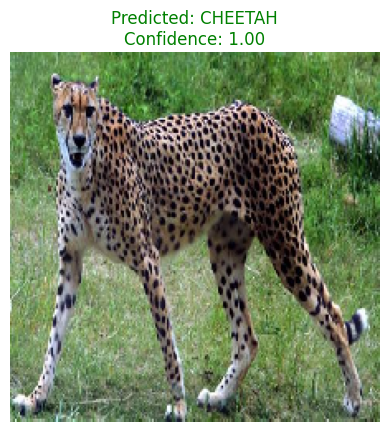

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


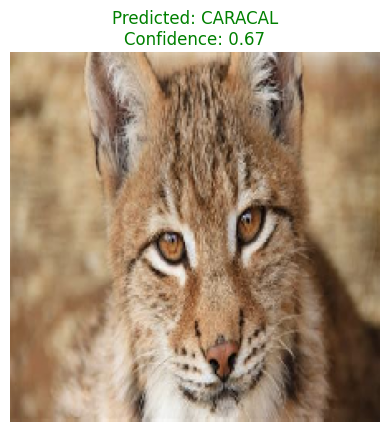

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


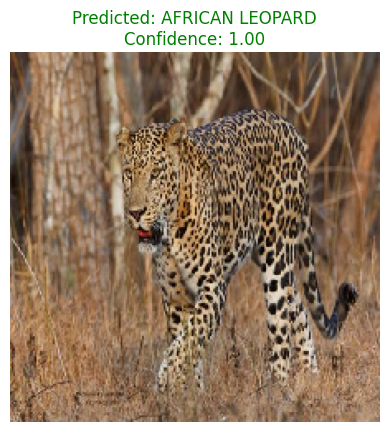

In [45]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Experiment 3: ResNet SGD***

In [46]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

In [47]:
model.compile(
        optimizer=SGD(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,641,930 (94.00 MB)

 Trainable params: 15,504,394 (59.14 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [48]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [49]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - accuracy: 0.1307 - loss: 2.6467
Epoch 1: val_loss improved from inf to 1.85745, saving model to best_model.h5.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 40s 531ms/step - accuracy: 0.1314 - loss: 2.6433 - val_accuracy: 0.3578 - val_loss: 1.8575 - learning_rate: 0.0010
Epoch 2/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - accuracy: 0.3047 - loss: 2.0034
Epoch 2: val_loss improved from 1.85745 to 1.40552, saving model to best_model.h5.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 22s 376ms/step - accuracy: 0.3054 - loss: 2.0011 - val_accuracy: 0.6121 - val_loss: 1.4055 - learning_rate: 0.0010
Epoch 3/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - accuracy: 0.4654 - loss: 1.6211
Epoch 3: val_loss improved from 1.40552 to 1.14211, saving model to best_model.h5.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 22s 376ms/step - accuracy: 0.4659 - loss: 1.6198 - val_accuracy: 0.7047 - val_loss: 1.1421 - learning_rate: 0.0010
Epoch 4/50
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - ac

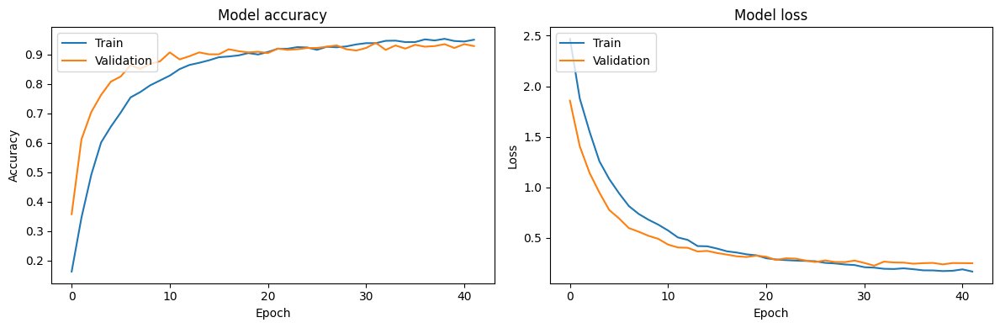

In [50]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 220ms/step - accuracy: 0.9148 - loss: 0.2406
Test Accuracy: 93.80%
8/8 ━━━━━━━━━━━━━━━━━━━━ 6s 419ms/step


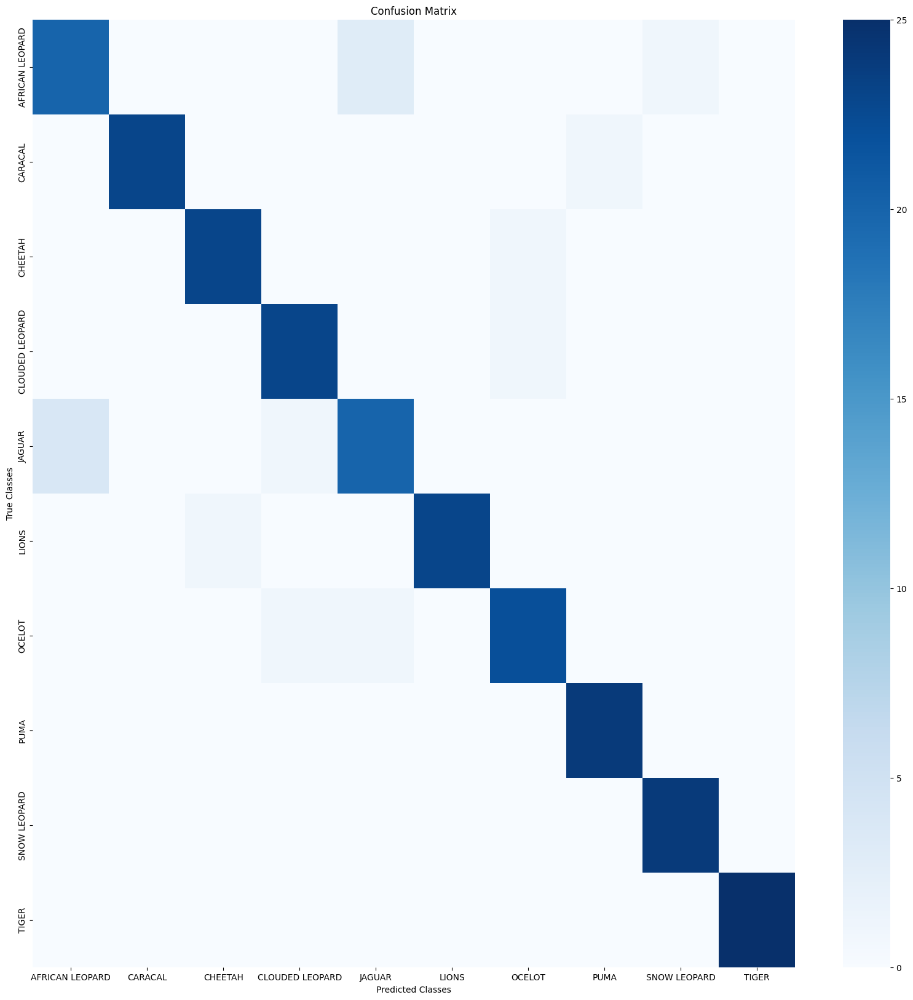

                 precision    recall  f1-score   support

AFRICAN LEOPARD       0.83      0.83      0.83        24
        CARACAL       1.00      0.96      0.98        24
        CHEETAH       0.96      0.96      0.96        24
CLOUDED LEOPARD       0.92      0.96      0.94        24
         JAGUAR       0.83      0.80      0.82        25
          LIONS       1.00      0.96      0.98        24
         OCELOT       0.92      0.92      0.92        24
           PUMA       0.96      1.00      0.98        24
   SNOW LEOPARD       0.96      1.00      0.98        24
          TIGER       1.00      1.00      1.00        25

       accuracy                           0.94       242
      macro avg       0.94      0.94      0.94       242
   weighted avg       0.94      0.94      0.94       242



In [51]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


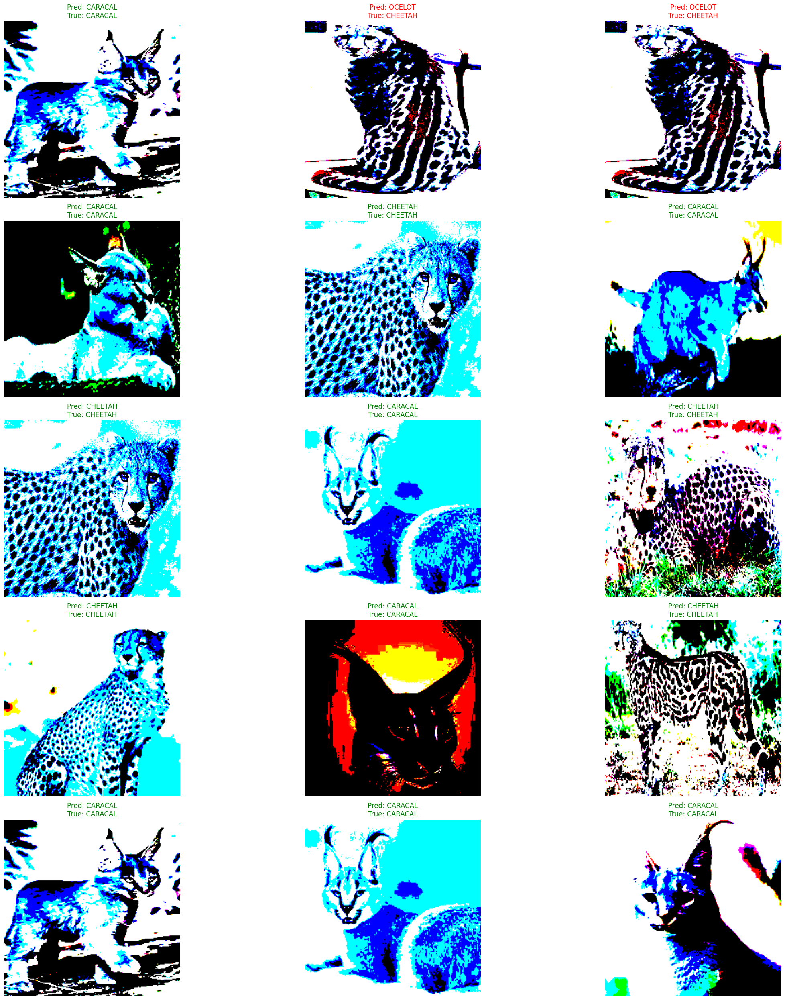

In [52]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


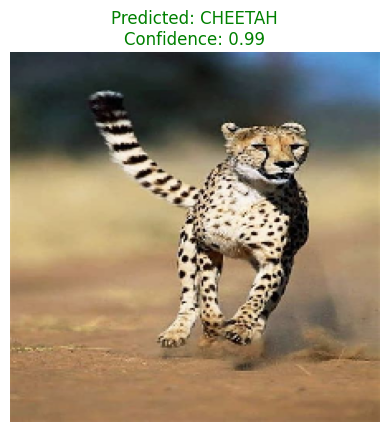

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


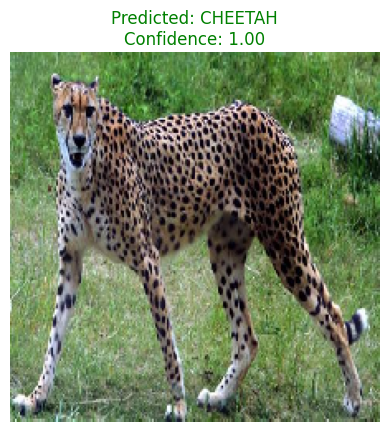

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


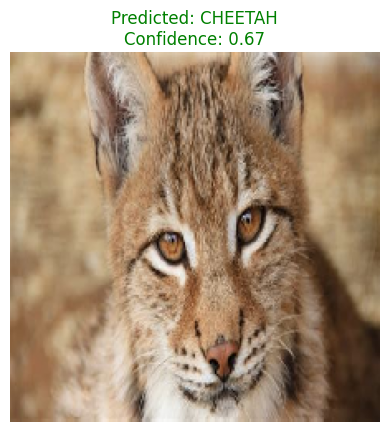

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


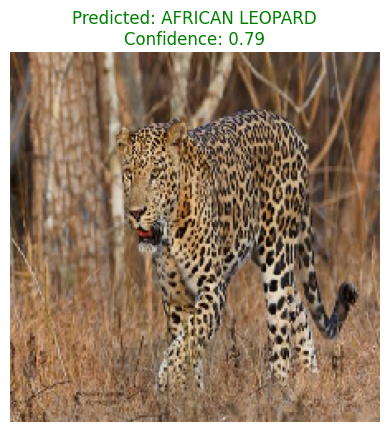

In [53]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

**Experiment 4: VGG16**

In [54]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 1633 images belonging to 10 classes.
Found 464 images belonging to 10 classes.
Found 242 images belonging to 10 classes.


In [55]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,330,186 (268.29 MB)

 Trainable params: 55,607,306 (212.13 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [56]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [57]:
history = model.fit(
        train_generator,
        epochs=15,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/15


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step - accuracy: 0.3809 - loss: 1.9535
Epoch 1: val_loss improved from inf to 0.59509, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 30s 473ms/step - accuracy: 0.3840 - loss: 1.9427 - val_accuracy: 0.7909 - val_loss: 0.5951
Epoch 2/15
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7317 - loss: 0.7727
Epoch 2: val_loss improved from 0.59509 to 0.41205, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 25s 437ms/step - accuracy: 0.7324 - loss: 0.7706 - val_accuracy: 0.8707 - val_loss: 0.4120
Epoch 3/15
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step - accuracy: 0.8314 - loss: 0.5469
Epoch 3: val_loss improved from 0.41205 to 0.37474, saving model to ./base.model.keras
52/52 ━━━━━━━━━━━━━━━━━━━━ 25s 446ms/step - accuracy: 0.8315 - loss: 0.5463 - val_accuracy: 0.8987 - val_loss: 0.3747
Epoch 4/15
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step - accuracy: 0.8542 - loss: 0.4432
Epoch 4: val_loss improved from 0.37474 to 0.31522, savi

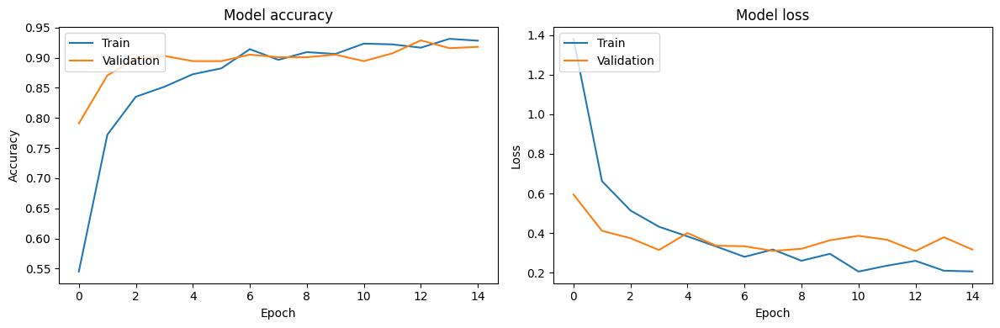

In [58]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step - accuracy: 0.9071 - loss: 0.3983
Test Accuracy: 93.39%
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step


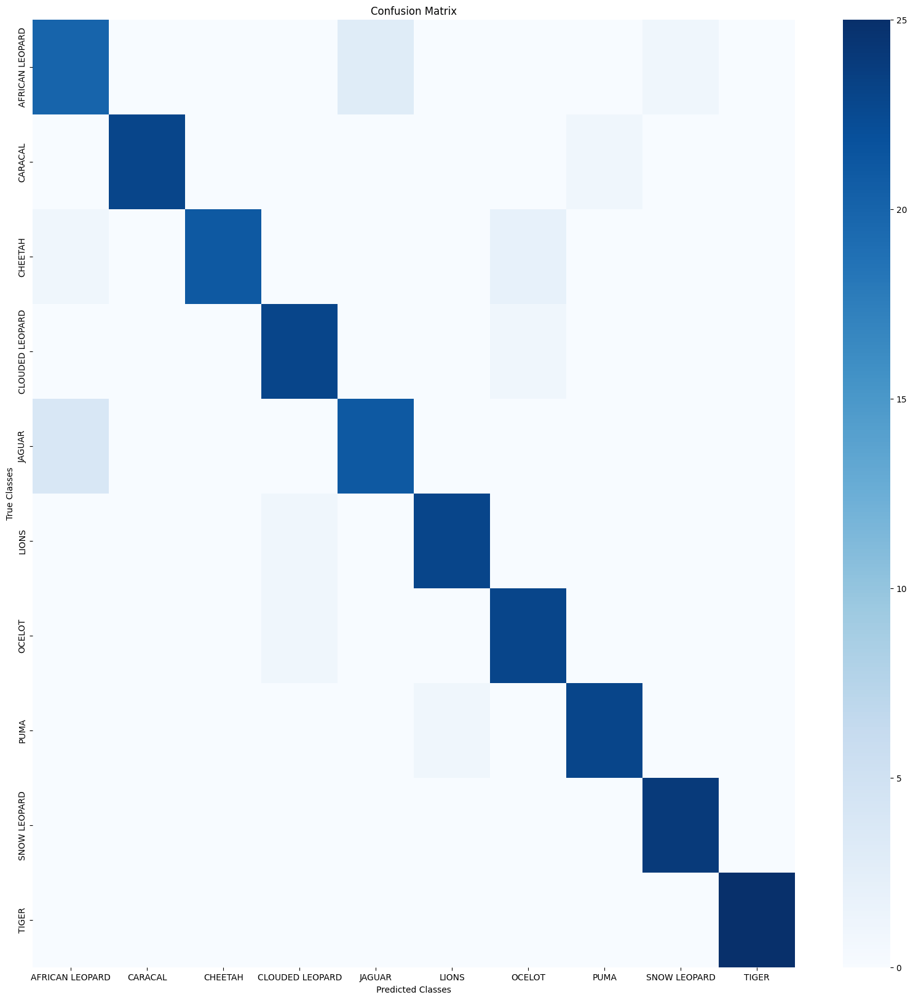

                 precision    recall  f1-score   support

AFRICAN LEOPARD       0.80      0.83      0.82        24
        CARACAL       1.00      0.96      0.98        24
        CHEETAH       1.00      0.88      0.93        24
CLOUDED LEOPARD       0.92      0.96      0.94        24
         JAGUAR       0.88      0.84      0.86        25
          LIONS       0.96      0.96      0.96        24
         OCELOT       0.88      0.96      0.92        24
           PUMA       0.96      0.96      0.96        24
   SNOW LEOPARD       0.96      1.00      0.98        24
          TIGER       1.00      1.00      1.00        25

       accuracy                           0.93       242
      macro avg       0.94      0.93      0.93       242
   weighted avg       0.94      0.93      0.93       242



In [59]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


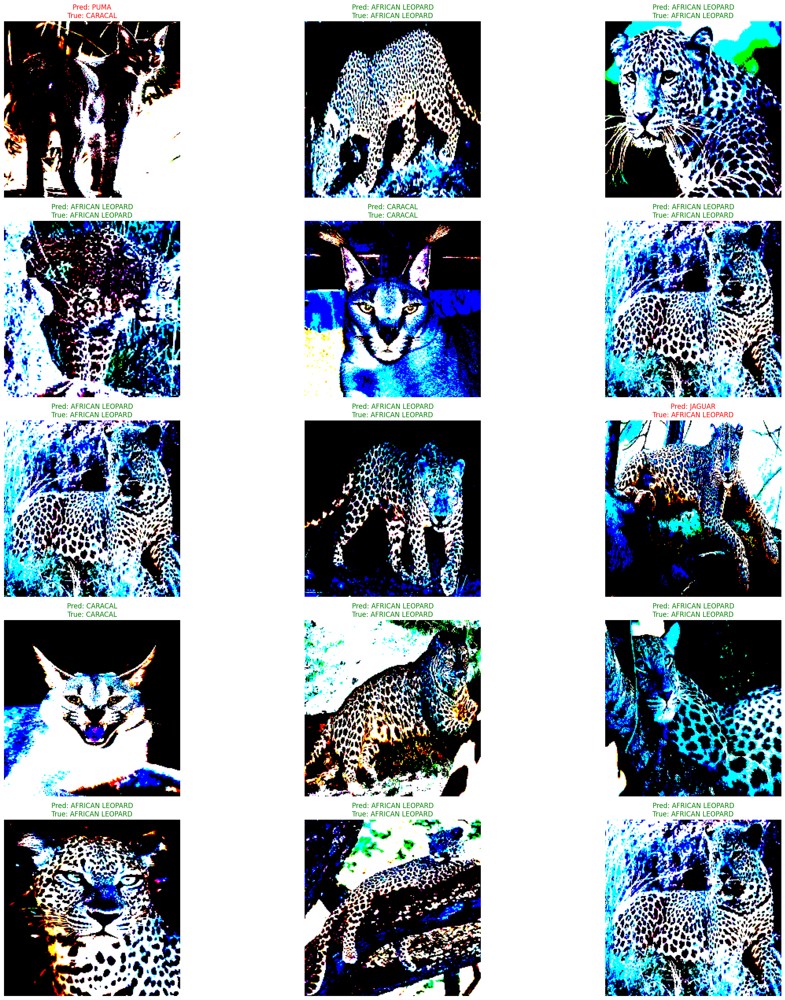

In [60]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


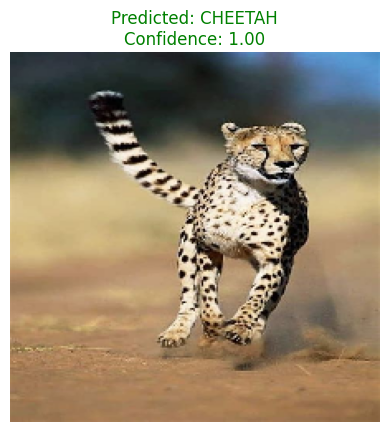

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


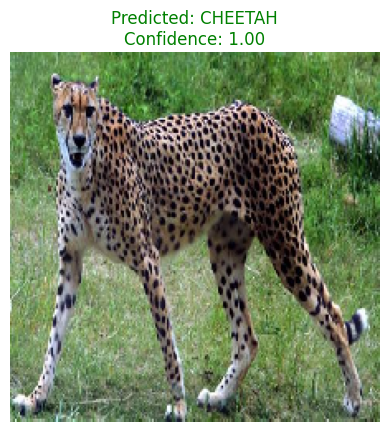

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


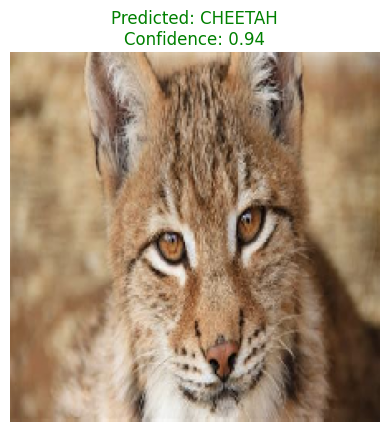

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


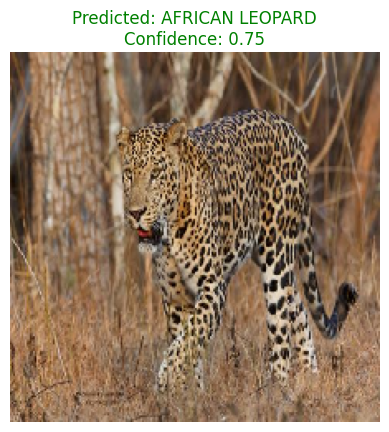

In [61]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

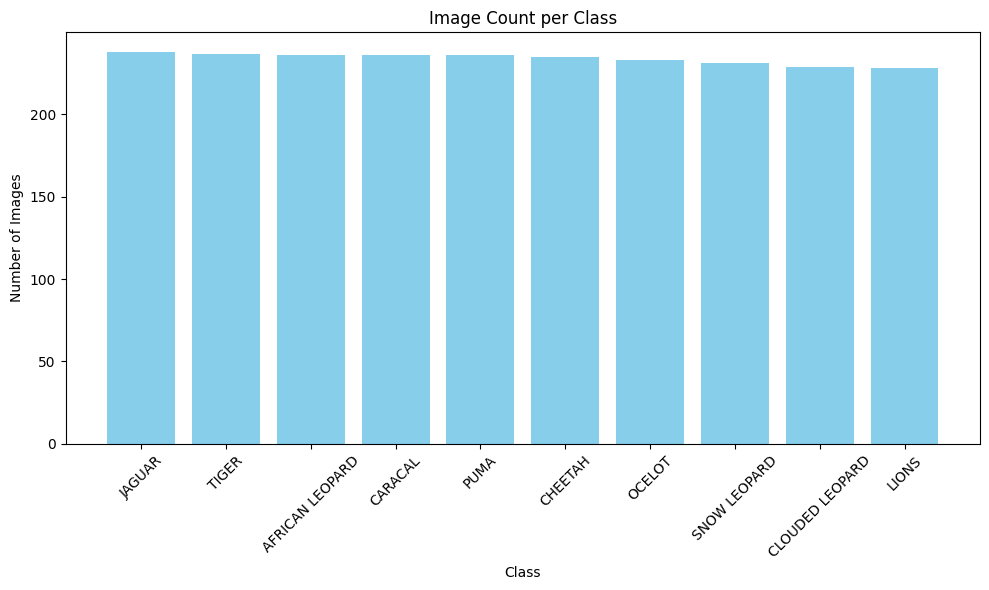

In [62]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Path to your dataset directory (each class is a folder)
dataset_dir = path

# Get class names and image counts
data = []
for class_name in os.listdir(dataset_dir):
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        image_count = len([f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))])
        data.append({'Class': class_name, 'Image Count': image_count})

# Create DataFrame
df = pd.DataFrame(data)

# Sort by image count (optional)
df = df.sort_values('Image Count', ascending=False)

# Plot
plt.figure(figsize=(10, 6))
plt.bar(df['Class'], df['Image Count'], color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Image Count per Class')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [63]:
# Add percentage column
df['Percentage'] = (df['Image Count'] / df['Image Count'].sum()) * 100

# Display the table
print(df)

# Optional: Round percentages
df['Percentage'] = df['Percentage'].round(2)

             Class  Image Count  Percentage
7           JAGUAR          238   10.175289
4            TIGER          237   10.132535
9  AFRICAN LEOPARD          236   10.089782
3          CARACAL          236   10.089782
6             PUMA          236   10.089782
0          CHEETAH          235   10.047029
8           OCELOT          233    9.961522
2     SNOW LEOPARD          231    9.876015
5  CLOUDED LEOPARD          229    9.790509
1            LIONS          228    9.747755


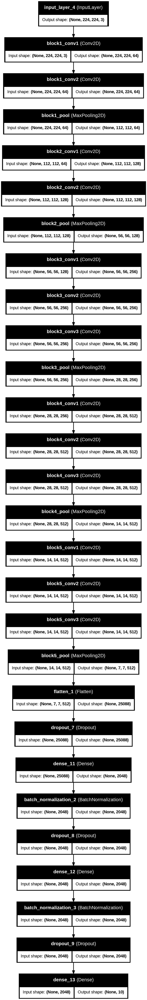

In [64]:
from tensorflow.keras.utils import plot_model

plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)
